---
## Step 0: Load The Data

In [1]:
# Load pickled data
import pickle
from skimage import color
from skimage.color import rgb2ycbcr
from skimage.exposure import equalize_adapthist
from sklearn.utils import shuffle
import cv2
import numpy as np
from pathlib import Path

with open("data/train.p", mode='rb') as f:
    train = pickle.load(f)

with open("data/valid.p", mode='rb') as f:
    valid = pickle.load(f)

balanced = None
if Path("data/balanced_grey.p").is_file():
    with open("data/balanced_grey.p", mode='rb') as f:
        balanced = pickle.load(f)
  
balanced_aug = None
if Path("data/balanced_aug_grey.p").is_file():
    with open("data/balanced_aug_grey.p", mode='rb') as f:
        balanced_aug = pickle.load(f)
   
# combine training and validation datasets and map
# them by label.
img_orig_dict = {}
for i in range(0, len(train['labels'])):
    k = train['labels'][i]
    img_orig = train['features'][i]
    if k in img_orig_dict:
        img_orig_dict[k].append(img_orig)
    else:
        img_orig_dict[k] = [img_orig]
        
for i in range(0, len(valid['labels'])):
    k = valid['labels'][i]
    img_orig = valid['features'][i]
    if k in img_orig_dict:
        img_orig_dict[k].append(img_orig)
    else:
        img_orig_dict[k] = [img_orig]
        
max_k = None
min_k = None          
for k, v in img_orig_dict.items():
    if max_k is None or len(img_orig_dict[max_k]) < len(v):
        max_k = k
    
    if min_k is None or len(img_orig_dict[min_k]) > len(v):
        min_k = k

In [2]:
### Helper APIs use through out.

import matplotlib.pyplot as plt
%matplotlib inline

from numpy import random
from skimage.transform import warp
from skimage.transform import AffineTransform, ProjectiveTransform

# some help from http://blog.yhat.com/posts/image-processing-with-scikit-image.html
from skimage.filters import gaussian
from skimage.color import rgb2gray
from skimage.exposure import equalize_adapthist, equalize_hist

from joblib import Parallel, delayed

import warnings
warnings.simplefilter('ignore', UserWarning)

import time

def _rbg_CLAHE(img):
    return equalize_adapthist(img/np.max(np.abs(img)))

def _rbg_to_y_CLAHE(img):
    img = rgb2ycbcr(img)[:,:,0]
    return np.resize(equalize_adapthist(img/np.max(np.abs(img))), (img.shape[0], img.shape[1], 1))

def rbg_to_y_CLAHE(feature_list):
    return Parallel(n_jobs=8)(delayed(_rbg_to_y_CLAHE)(i) for i in feature_list)

def rbg_CLAHE(feature_list):
    return Parallel(n_jobs=8)(delayed(_rbg_CLAHE)(i) for i in feature_list)

def random_affine(img, intensity=1.0, rotationDisabled=False, shearDisabled=False, scaleDisabled=False):
    if rotationDisabled:
        rotation = None
    else:
        rotation = random.uniform(-.15*intensity, .15*intensity)
    
    if shearDisabled:
        shear = None
    else:
        shear = random.uniform(-.15*intensity, .15*intensity)
        
    if scaleDisabled:
        scale = None
    else:
        scale_rnd = random.uniform(.9, 1.1)
        scale=(scale_rnd, scale_rnd)

    return warp(img, inverse_map=AffineTransform(rotation=rotation, shear=shear, scale=scale),  mode='edge')

def random_affine_m(img_list, intensity=1.0, rotationDisabled=False, shearDisabled=False, scaleDisabled=False):
    return Parallel(n_jobs=8)(delayed(random_affine)(i, intensity=intensity, 
                                                     rotationDisabled=rotationDisabled, 
                                                     shearDisabled=shearDisabled, 
                                                     scaleDisabled=scaleDisabled) for i in img_list)
def motion_blur(img):
    n = random.randint(4,6)
    kernel_motion_blur = np.zeros((n,  n))
    kernel_motion_blur[int((n-1)/2), :] = np.ones(n)
    kernel_motion_blur = kernel_motion_blur / n
    return np.resize(cv2.filter2D(img, -1, kernel_motion_blur), (img.shape[0], img.shape[1], 1))

def motion_blur_m(img_list):
    return Parallel(n_jobs=8)(delayed(motion_blur)(i) for i in img_list)

def gaussian_blur(img):
    return gaussian(img,sigma=1.0)

def gaussian_blur_m(img_list):
    return Parallel(n_jobs=8)(delayed(gaussian_blur)(i) for i in img_list)

def show_images(images,titles=None):
    """Display a list of images"""
    n_ims = len(images)
    if titles is None: titles = ['(%d)' % i for i in range(1,n_ims + 1)]
    fig = plt.figure()
    n = 1
    for image,title in zip(images,titles):
        a = fig.add_subplot(1,n_ims,n) # Make subplot
        if len(image.shape) == 2 or image.shape[2] == 1: # Is image grayscale?
            plt.imshow(np.resize(image, (image.shape[0], image.shape[1])), interpolation="bicubic", cmap="gray") # Only place in this blog you can't replace 'gray' with 'grey'
        else:
            plt.imshow(image, interpolation="bicubic")
        if titles is not None:
            a.set_title(title)
        n += 1
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_ims)
    plt.axis('off')
    plt.show()

def apply_projection_transform(img, intensity=0.75):
    image_size = img.shape[0]
    d = float(image_size) * 0.3 * intensity
    tl_top = random.uniform(-d, d)     # Top left corner, top margin
    tl_left = random.uniform(-d, d)    # Top left corner, left margin
    bl_bottom = random.uniform(-d, d)  # Bottom left corner, bottom margin
    bl_left = random.uniform(-d, d)    # Bottom left corner, left margin
    tr_top = random.uniform(-d, d)     # Top right corner, top margin
    tr_right = random.uniform(-d, d)   # Top right corner, right margin
    br_bottom = random.uniform(-d, d)  # Bottom right corner, bottom margin
    br_right = random.uniform(-d, d)   # Bottom right corner, right margin

    transform = ProjectiveTransform()
    transform.estimate(np.array((
        (tl_left, tl_top),
        (bl_left, image_size - bl_bottom),
        (image_size - br_right, image_size - br_bottom),
        (image_size - tr_right, tr_top)
    )), np.array((
        (0, 0),
        (0, image_size),
        (image_size, image_size),
        (image_size, 0)
    )))
    
    return warp(img, transform, output_shape=(image_size, image_size, 1), order = 1, mode = 'edge')
  
def apply_projection_transform_m(img_list, intensity=0.75):
    return Parallel(n_jobs=8)(delayed(apply_projection_transform)(i, intensity=intensity) for i in img_list)

def apply_random_transform_type1(img, intensity=0.3):
    """
    Used to equalize the dataset
    """
    i = random.randint(0, 6)
    if i == 0:
        return random_affine(img, intensity=intensity, shearDisabled=True, scaleDisabled=True)
    elif i == 1:
        return random_affine(img, intensity=intensity, rotationDisabled=True, scaleDisabled=True)
    elif i == 2:
        return random_affine(img, intensity=intensity, rotationDisabled=True,  shearDisabled=True)
    elif i == 3:
        return random_affine(img, intensity=intensity)
    elif i == 4:
        return gaussian_blur(img)
    elif i == 5:
        return motion_blur(img)
    
def apply_transforms_type2(img, intensity=1.0):
    """
    Used to agument the dataset
    """
    return [img, apply_projection_transform(img, intensity=0.75), apply_projection_transform(img, intensity=0.75),
            apply_projection_transform(img, intensity=0.75), apply_projection_transform(img, intensity=0.75)]
    
def generate_type1_set(img_list, output_size, intensity=1.0):
    random.shuffle(img_list)
    
    gen_img_list = []
    count = 0
    s = 0
    e = 8
    while (count < output_size):
        r = Parallel(n_jobs=8)(delayed(apply_random_transform_type1)(i, intensity=intensity) for i in img_list[s:e])
        count += len(r)
        gen_img_list.extend(r)
        
        if e == len(img_list):
            s = 0
            e = 8
        else:
            s = e
            e = min(e+8, len(img_list))
            
    return gen_img_list

def load_signnames():
    sign_dict = {}
    with open('signnames.csv') as csvfile:
        signnames = csv.reader(csvfile)
        for row in signnames:
            if row[0].isdigit():
                sign_dict[int(row[0])] = row[1]
        return sign_dict

def log_progress(sequence, every=None, size=None, name='Items'):
    """
    https://github.com/alexanderkuk/log-progress
    """
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )

In [3]:
if balanced is None:
    # Bump up all the signs to 1.2 times the max sign set.
    max_len = 1.2*len(img_orig_dict[max_k])

    t0 = time.time()
    count = 1
    balanced = {'features': [], 'labels': []}
    for k, v in log_progress(img_orig_dict.items(), every=1, name='Generating balanced set from test set'):
        t0_0 = time.time()
        grey_y_list = rbg_to_y_CLAHE(v)
        grey_y_type1_set = generate_type1_set(grey_y_list, max_len - len(grey_y_list))
        grey_y_type1_set.extend(grey_y_list)
    
        balanced['features'].extend(grey_y_type1_set)
        balanced['labels'].extend([k]*len(grey_y_type1_set))
        t1_1 = time.time()
        # print ("Time taken {} for {}, original size {}, new size {}".format(int(t1_1 - t0_0), count, len(grey_y_list), len(grey_y_type1_set)))
        count += 1
    t1 = time.time()
    print ("Time taken: {}".format(int(t1 - t0)))
    pickle.dump(balanced, open( "data/balanced_grey.p", "wb" ))

In [4]:
import itertools
    
dataset_to_use = balanced_aug # replace with balanced_aug to enable training on 5x the balanced data.

img_bal_dict = {}
for i in range(0, len(balanced['labels'])):
    k = balanced['labels'][i]
    img = balanced['features'][i]
    if k in img_bal_dict:
        img_bal_dict[k].append(img)
    else:
        img_bal_dict[k] = [img]

if dataset_to_use is None and balanced_aug is None:
    t0 = time.time()
    count = 1
    balanced_aug = {'features': [], 'labels': []}
    for k, v in log_progress(img_bal_dict.items(), every=1, name='Generating augumented set from balanced set'):
        t0_0 = time.time()
        type2_list = list(itertools.chain.from_iterable(Parallel(n_jobs=8)(delayed(apply_transforms_type2)(i) for i in v))) 
    
        balanced_aug['features'].extend(type2_list)
        balanced_aug['labels'].extend([k]*len(type2_list))
        t1_1 = time.time()
        # print ("Time taken {} for {}, original size {}, new size {}".format(int(t1_1 - t0_0), count, len(v), len(type2_list)))
        count += 1
    t1 = time.time()
    print ("Time taken: {}".format(int(t1 - t0)))
    print("Given image count: {}, Augmented image count: {}".format(len(balanced['labels']), len(balanced_aug['features'])))
    pickle.dump(balanced_aug, open( "data/balanced_aug_grey.p", "wb" ))
    dataset_to_use = balanced_aug


In [5]:
from sklearn.model_selection import train_test_split

testing_file = "data/test.p"

with open(testing_file, mode='rb') as f:
    test = pickle.load(f)

X_train, X_valid, y_train, y_valid = train_test_split(dataset_to_use['features'],
                                                    dataset_to_use['labels'],
                                                    test_size=0.20, random_state=42)
test_dict = {}
for i in range(0, len(test['labels'])):
    k = test['labels'][i]
    img = test['features'][i]
    if k in test_dict:
        test_dict[k].append(img)
    else:
        test_dict[k] = [img]

t0 = time.time()
count = 0
test = {'features': [], 'labels': []}
test_processed = {'features': [], 'labels': []}
for k, v in log_progress(test_dict.items(), every=1, name='Processing test images from RGB to Y with CLAHE'):
    t0_0 = time.time()
    y_list = Parallel(n_jobs=8)(delayed(_rbg_to_y_CLAHE)(i) for i in v)
    
    test['features'].extend(v)
    test['labels'].extend([k]*len(y_list))
    test_processed['features'].extend(y_list)
    test_processed['labels'].extend([k]*len(y_list))
    t1_1 = time.time()
    # print ("Time taken {} for {}, original size {}, new size {}".format(int(t1_1 - t0_0), count, len(v), len(y_list)))
    count += 1
t1 = time.time()
print ("Time taken: {}".format(int(t1 - t0)))
    
X_test, y_test = test_processed['features'], test_processed['labels']

Time taken: 55


# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

---

## Step 1: Dataset Summary & Exploration

### Provide a Basic Summary of the Data Set Using Python, Numpy and/or Pandas

In [6]:
import collections

# Number of training examples
n_train = len(X_train)

# Number of validation examples
n_validation = len(X_valid)

# Number of testing examples.
n_test = len(X_test)

# What's the shape of an traffic sign image?
image_shape = X_train[0].shape

# How many unique classes/labels there are in the dataset.
n_classes = np.unique(y_train).size

for x in X_train:
    if len(x.shape) != 3:
        print("Invalid shape: {}".format(x.shape))
        break

print("Number of training examples given = {}, after aug = {}".format(len(train['labels']), n_train))
print("Number of validation examples given = {}, after aug = {}".format(len(valid['labels']), n_validation))
print("Number of testing examples given = {}, after aug = {}".format(len(test['labels']), n_test))
print("Image data shape given = {}, after processing = {}".format(train['features'][0].shape, image_shape))
print("Number of classes =", n_classes)

Number of training examples given = 34799, after aug = 464868
Number of validation examples given = 4410, after aug = 116217
Number of testing examples given = 12630, after aug = 12630
Image data shape given = (32, 32, 3), after processing = (32, 32, 1)
Number of classes = 43


### Include an exploratory visualization of the dataset
Visualize the German Traffic Signs Dataset using the pickled file(s). This is open ended, suggestions include: plotting traffic sign images, plotting the count of each sign, etc.

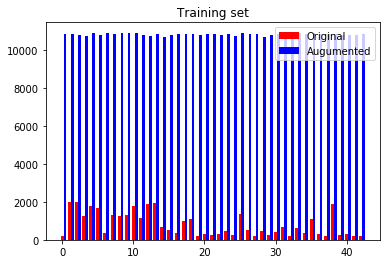

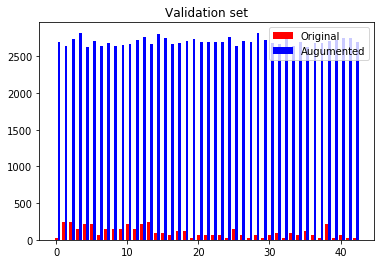

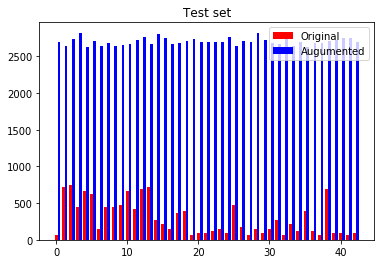

In [7]:
def get_counts(y):
    l = list(collections.Counter(y).items())
    l.sort(key=lambda x: x[0])
    l = [ x[1] for x in l ]
    return l

def plot_set_dist(y_orig, y_aug, size, desc, save_name, c1='r', c2='b'):
    width = 0.4
    fig, ax = plt.subplots()
    p1 = ax.bar(np.arange(size), get_counts(y_orig), width, color=c1)
    p2 = ax.bar(np.arange(size) + width, get_counts(y_aug), width, color=c2)
    ax.legend((p1[0], p2[0]), ('Original', 'Augumented'))
    ax.set_title(desc)
    plt.show()
    plt.draw()
    fig.savefig("examples/" + save_name + ".png")
    

plot_set_dist(train['labels'], y_train, n_classes, "Training set", "train_set")

plot_set_dist(valid['labels'], y_valid, n_classes, "Validation set", "valid_set")

plot_set_dist(test['labels'], y_valid, n_classes, "Test set", "test_set")

5-Speed limit (80km/h)


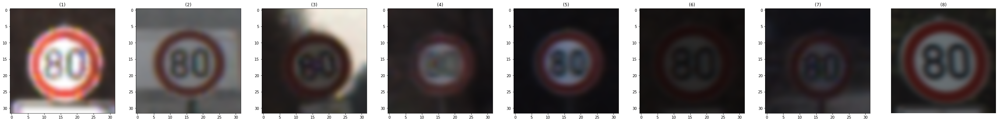

20-Dangerous curve to the right


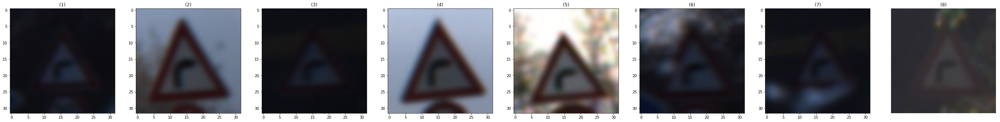

39-Keep left


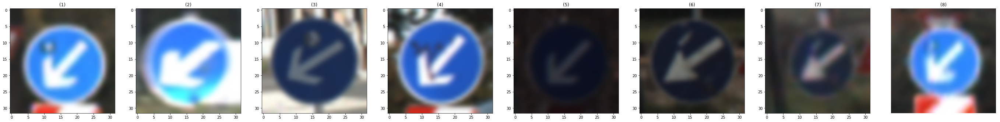

10-No passing for vehicles over 3.5 metric tons


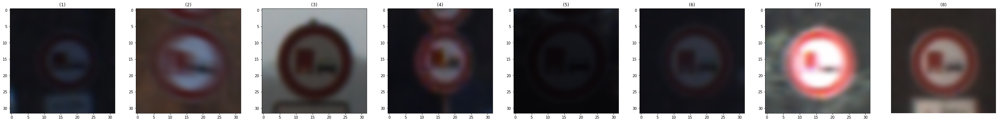

19-Dangerous curve to the left


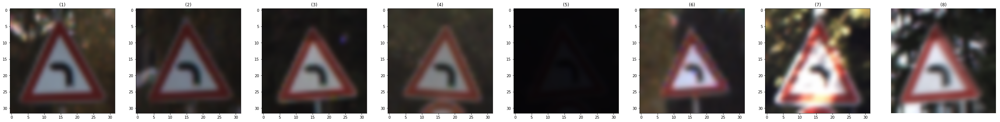

In [8]:
### Look at few random images from few randomg labels.
import csv
import matplotlib.pyplot as plt
# Visualizations will be shown in the notebook.
%matplotlib inline

sign_dict = load_signnames()

rnd_imgs_with_class = []
for i in np.random.randint(1, n_classes, 5):
    r = np.random.randint(1, len(img_orig_dict[i]), 8)
    img_list = [ img_orig_dict[i][x] for x in r ]
    img_name = "{}-{}".format(i, sign_dict[i])
    rnd_imgs_with_class.append((img_name, img_list))
    print("{}".format(img_name))
    show_images(img_list)

----

## Step 2: Design and Test a Model Architecture

Both the [published baseline model on this problem](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf) and [`A Committee of Neural Networks for Traffic Sign Classification`](http://people.idsia.ch/~juergen/ijcnn2011.pdf) are tried and I choose the second architecture model to show case the results since it seems to be performing better with the amount of time spent on training with the balanced and agumented data set.

### Pre-process the Data Set (normalization, grayscale, etc.)

Image are converted to greyscale and CLAHE is applied. Then it is normalized so that the data
has mean zero and equal variance.

In [9]:
# Images already converted to grey scale above and CLAHE is applied.
t_mean = np.mean(X_train, axis=0)
t_std = np.std(X_train, axis=0)

X_train = X_train - t_mean
X_train = X_train / t_std

X_valid = X_valid - t_mean
X_valid = X_valid / t_std

X_test = X_test  - t_mean
X_test = X_test / t_std

---

### Show the various transformations for few random images for 5 random classes.

5-Speed limit (80km/h)


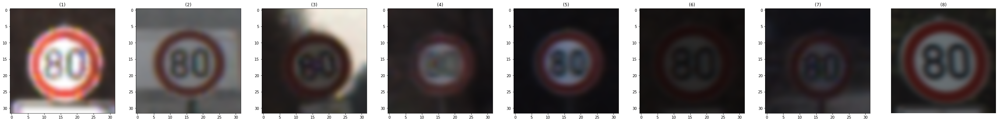

5-Speed limit (80km/h)-y-CLAHE


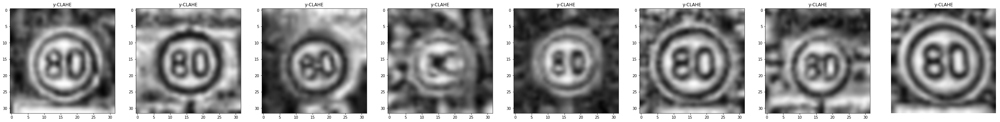

5-Speed limit (80km/h)-affine


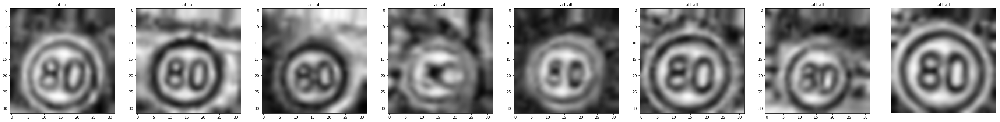

5-Speed limit (80km/h)-gaussian-blur


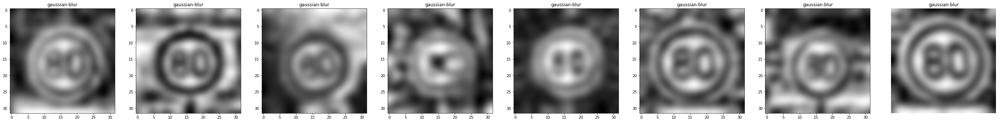

5-Speed limit (80km/h)-motion-blur


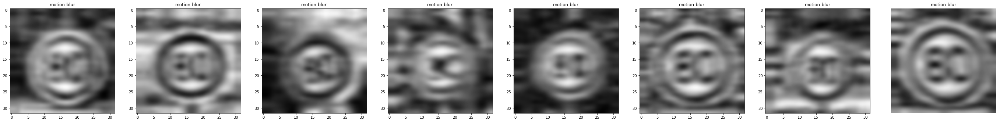

5-Speed limit (80km/h)-projective


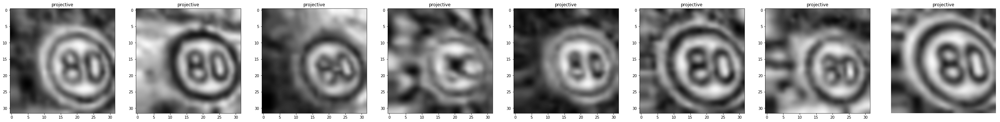

20-Dangerous curve to the right


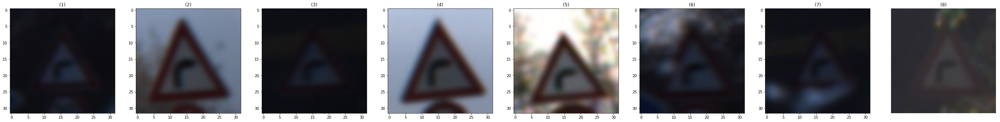

20-Dangerous curve to the right-y-CLAHE


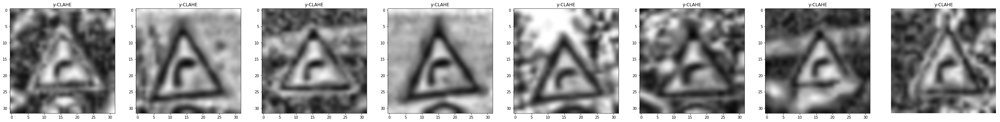

20-Dangerous curve to the right-affine


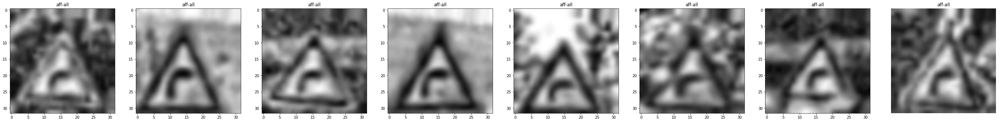

20-Dangerous curve to the right-gaussian-blur


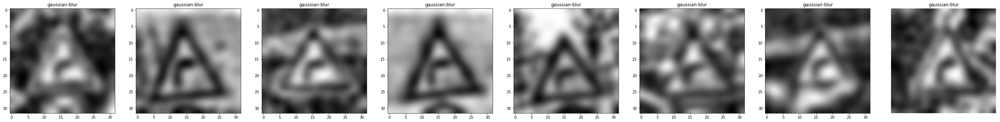

20-Dangerous curve to the right-motion-blur


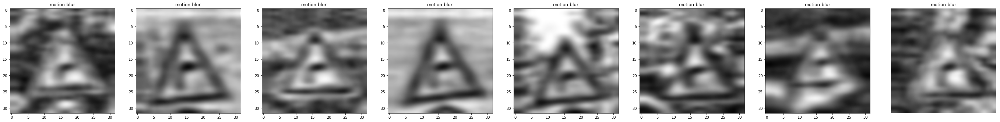

20-Dangerous curve to the right-projective


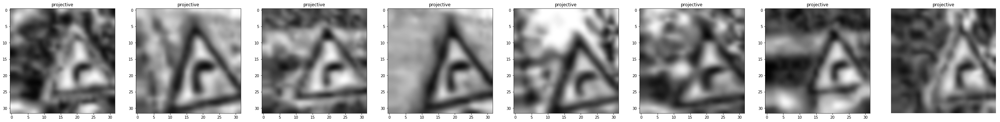

39-Keep left


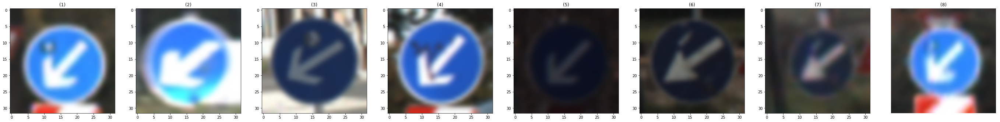

39-Keep left-y-CLAHE


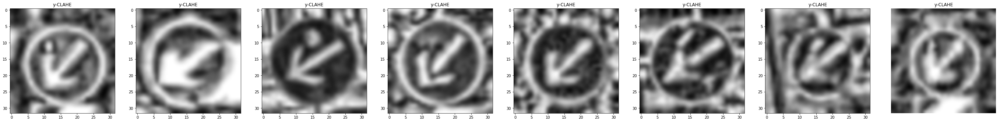

39-Keep left-affine


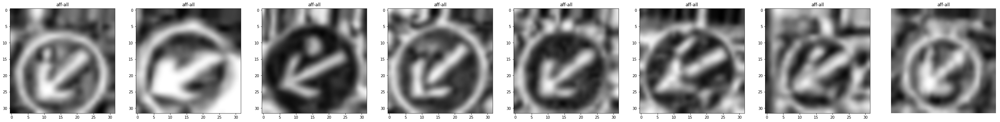

39-Keep left-gaussian-blur


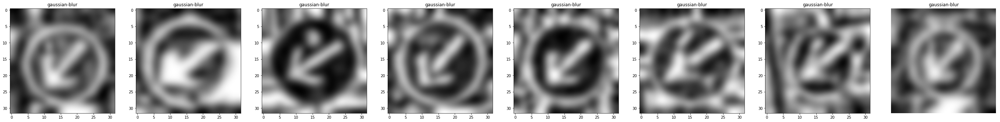

39-Keep left-motion-blur


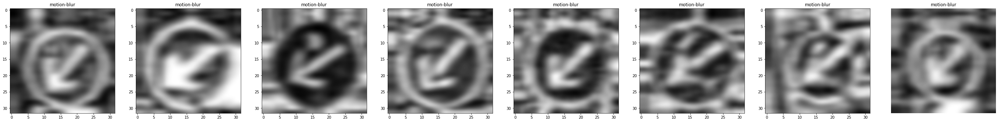

39-Keep left-projective


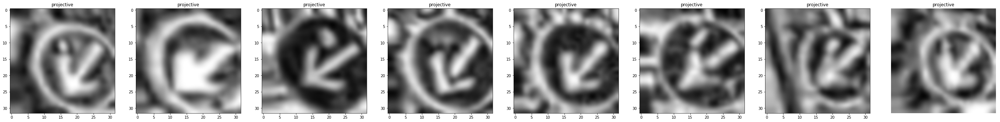

10-No passing for vehicles over 3.5 metric tons


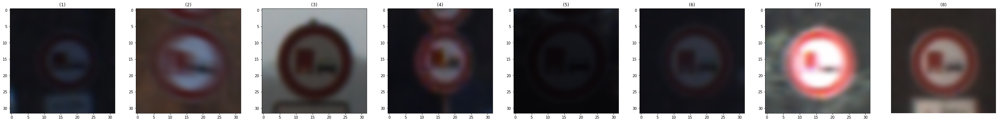

10-No passing for vehicles over 3.5 metric tons-y-CLAHE


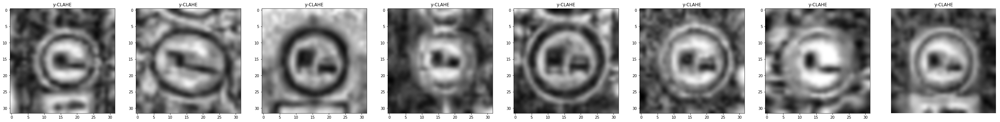

10-No passing for vehicles over 3.5 metric tons-affine


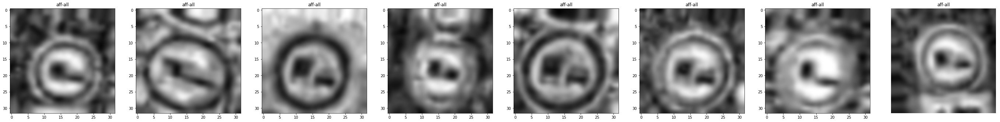

10-No passing for vehicles over 3.5 metric tons-gaussian-blur


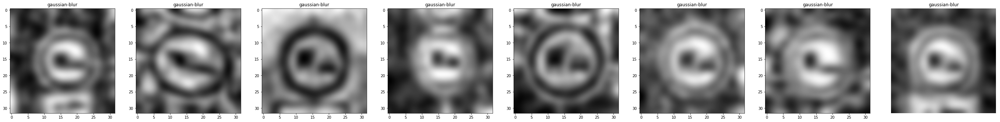

10-No passing for vehicles over 3.5 metric tons-motion-blur


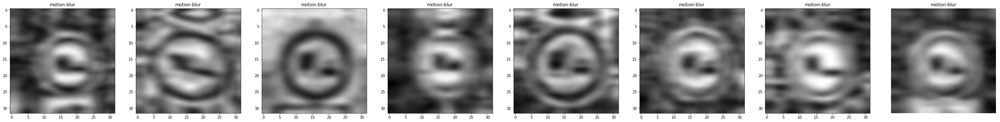

10-No passing for vehicles over 3.5 metric tons-projective


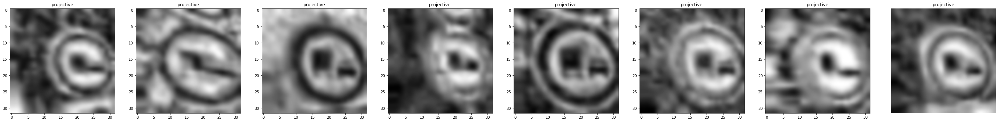

19-Dangerous curve to the left


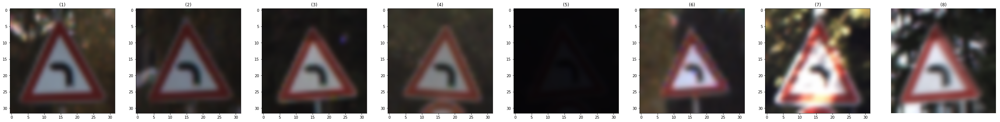

19-Dangerous curve to the left-y-CLAHE


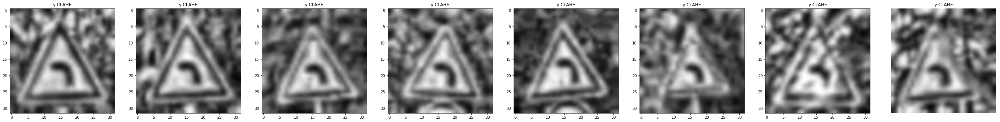

19-Dangerous curve to the left-affine


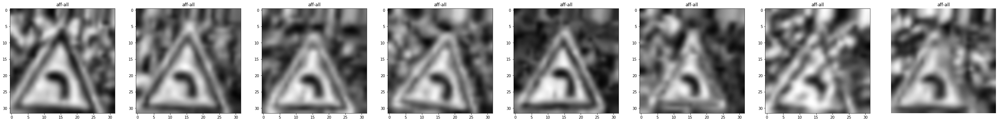

19-Dangerous curve to the left-gaussian-blur


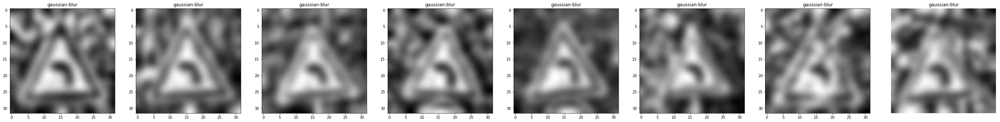

19-Dangerous curve to the left-motion-blur


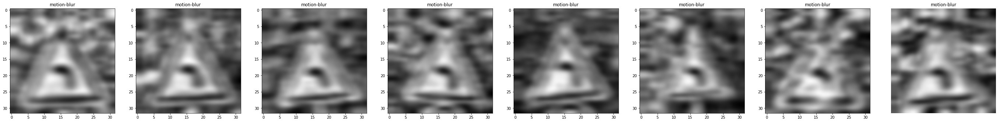

19-Dangerous curve to the left-projective


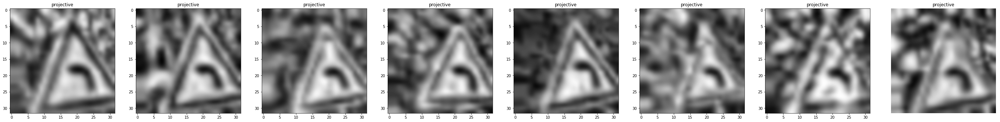

[None, None, None, None, None]

In [10]:
def display_orig_and_transforms(img_label, img_orig_list):
    intensity=1.0
    print(img_label)
    show_images(img_orig_list)
    
    print("{}-{}".format(img_label, "y-CLAHE"))
    img_y_list = rbg_to_y_CLAHE(img_orig_list)
    show_images(img_y_list, ["y-CLAHE"]*len(img_orig_list))
    print("{}-{}".format(img_label, "affine"))
    show_images(random_affine_m(img_y_list, intensity=intensity), ["aff-all"]*len(img_orig_list))
    print("{}-{}".format(img_label, "gaussian-blur"))
    show_images(gaussian_blur_m(img_y_list), ["gaussian-blur"]*len(img_orig_list))
    print("{}-{}".format(img_label, "motion-blur"))
    show_images(motion_blur_m(img_y_list), ["motion-blur"]*len(img_orig_list))
    print("{}-{}".format(img_label, "projective"))
    show_images(apply_projection_transform_m(img_y_list, intensity=0.75), ["projective"]*len(img_orig_list))
    
   
[ display_orig_and_transforms(x[0], x[1]) for x in rnd_imgs_with_class ]

Turn right ahead


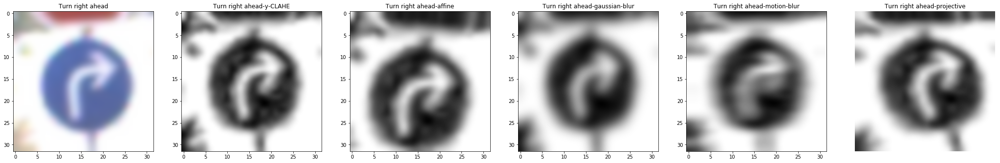

In [11]:
from scipy.misc import imsave
from skimage.transform import resize

def output_image(img, img_name, prefix="examples"):
    imsave(str(prefix) + "/" + str(img_name) + ".png", resize(img, output_shape=(128, 128)))

def output_transforms(img_label, img_orig):
    intensity=1.0
    print(img_label)
    img_list = [img_orig]
    img_name_list = [img_label]
    
    output_image(img_orig, "img_o")
    img_y = _rbg_to_y_CLAHE(img_orig)
    
    img_list.append(img_y)
    img_name_list.append("{}-{}".format(img_label, "y-CLAHE"))
    output_image(img_y.squeeze(), "img_y")

    img_a = random_affine(img_y, intensity=intensity)
    img_list.append(img_a)
    img_name_list.append("{}-{}".format(img_label, "affine"))
    output_image(img_a.squeeze(), "img_a")

    img_g = gaussian_blur(img_y)
    img_list.append(img_g)
    img_name_list.append("{}-{}".format(img_label, "gaussian-blur"))
    output_image(img_g.squeeze(), "img_g")
                         
    img_m = motion_blur(img_y)
    img_list.append(img_m)
    img_name_list.append("{}-{}".format(img_label, "motion-blur"))
    output_image(img_m.squeeze(), "img_m")     
                         
    img_p = apply_projection_transform(img_y, intensity=0.75)
    img_list.append(img_p)
    img_name_list.append("{}-{}".format(img_label, "projective"))
    output_image(img_p.squeeze(), "img_p")

    show_images(img_list, img_name_list)

output_transforms(sign_dict[33], img_orig_dict[33][70])

### Model Architecture

In [33]:
import tensorflow as tf
tf.reset_default_graph()

In [34]:
# Helpers
from tensorflow.contrib.layers import flatten

def conv2d(x, kernel, filters, strides=1, padding='SAME'):
    W = tf.get_variable("weights", 
                        shape=[kernel[0], kernel[1], x.get_shape()[3], filters], 
                        initializer=tf.contrib.layers.xavier_initializer())
    b = tf.get_variable("biases", shape=[filters], 
                        initializer=tf.contrib.layers.xavier_initializer())
    c = tf.nn.conv2d(x, W, strides=[1, strides, strides, 1], padding=padding)
    c = tf.nn.bias_add(c, b)
    return tf.nn.relu(c)    

def maxpool2d(x, k=2, padding='SAME'):
    return tf.nn.max_pool(
        x,
        ksize=[1, k, k, 1],
        strides=[1, k, k, 1],
        padding=padding)

def fully_connected(x, units, activation=True):
    W = tf.get_variable("weights", 
                        shape=[np.prod(x.get_shape().as_list()[1:]), units],
                        initializer=tf.contrib.layers.xavier_initializer())
    b = tf.get_variable("biases", shape=[units], 
                        initializer=tf.contrib.layers.xavier_initializer())
    
    fc = tf.add(tf.matmul(x, W), b)
    if activation:
        return tf.nn.relu(fc)
    else:
        return fc

### Seramnet Architecture

[`Traffic Sign Recognition with Multi-Scale Convolutional Networks`](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf)

Variation here that last two fully connected layers have 800 and 100 units with dropout of 0.5 for first layer and not dropout for second layer.

With respect to the two stages of convulutions attempted to train models using 108-200 and 108-108. Pooling layers have kernel 2x2 of stride 2. Skip layer is implemented as suggested. Only y-channel grey image input of 32x32x1 is used.

In [35]:
def LeNet(x, keep_prob, stages):
    """
    Traffic Sign Recognition with Multi-Scale Convolutional Networks
    http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
    """
    global conv1
    with tf.variable_scope('conv1'):
        conv1 = conv2d(x, kernel=[5, 5], filters=stages[0])
    
    with tf.variable_scope('pool1'):
       conv1pool = maxpool2d(conv1, k=2)
    
    # print("conv1pool shape: {}", conv1pool.shape)

    global conv2
    with tf.variable_scope('conv2'):
        conv2 = conv2d(conv1pool, kernel=[5, 5], filters=stages[1])

    with tf.variable_scope('pool2'):
        conv2pool = maxpool2d(conv2, k=2)

    pool1_reshape = tf.reshape(conv1pool, [-1, np.prod(conv1pool.get_shape().as_list()[1:])]) #s[0]*s[1]*s[2]])
    pool2_reshape = tf.reshape(conv2pool, [-1, np.prod(conv2pool.get_shape().as_list()[1:])])

    flattened = tf.concat([pool1_reshape, pool1_reshape], 1)

    with tf.variable_scope('fc1'):
        fc1 = fully_connected(flattened, 800)
        fc1 = tf.nn.dropout(fc1, keep_prob=keep_prob)


    with tf.variable_scope('fc2'):
        fc2 = fully_connected(fc1, 100)

    with tf.variable_scope('out'):
        logits = fully_connected(fc2, n_classes, activation=False)
    return logits

### CNN HOG3 Architecture

[`A Committee of Neural Networks for Traffic Sign Classification`](http://people.idsia.ch/~juergen/ijcnn2011.pdf)

Variation here that 5x5 convultions are used instead. Two fully connected last two layers are used instead of one and the first fully connected layer of size 1024 has dropout of 0.5 and last two fully connected layers of size 100 has no dropout.

Convultion filters of three stages (no skip layers like Seramnet) with 100, 150 and 250 sizes are used all being 5x5 with SAME padding. Pooling between each layer is standard with 2x2 kernel of stride 2.

Only y-channel grey image input of 32x32x1 is used.

In [36]:
def cnn_hog3(x, keep_prob, stages):
    """
    A Committee of Neural Networks for Traffic Sign Classification
    http://people.idsia.ch/~juergen/ijcnn2011.pdf
    """
    fc1_size = 1024
    fc2_size = 100
    global conv1
    with tf.variable_scope('conv1'):
        conv1 = conv2d(x, kernel=[5, 5], filters=stages[0])

    conv1pool = maxpool2d(conv1, k=2)

    global conv2
    with tf.variable_scope('conv2'):
        conv2 = conv2d(conv1pool, kernel=[5, 5], filters=stages[1])

    conv2pool = maxpool2d(conv2, k=2)

    global conv3
    with tf.variable_scope('conv3'):
        conv3 = conv2d(conv2pool, kernel=[5, 5], filters=stages[2])

    conv3pool = maxpool2d(conv3, k=2)

    flatten = tf.reshape(conv3pool, [-1, np.prod(conv3pool.get_shape().as_list()[1:])]) #s[0]*s[1]*s[2]])

    with tf.variable_scope('fc1'):
        fc1 = fully_connected(flatten, fc1_size)
        fc1 = tf.nn.dropout(fc1, keep_prob)

    with tf.variable_scope('fc2'):
        fc2 = fully_connected(fc1, fc2_size)

    with tf.variable_scope('out'):
        logits = fully_connected(fc2, n_classes, activation=False)
          
    print("conv1 {} -> pool1 {} -> conv2 {} -> pool2 {} -> conv3 {} -> pool3 {} -> flatten {} -> fc1 {} -> fc2 {} -> out {}"
          .format(conv1.shape[1:], conv1pool.shape[1:], conv2.shape[1:], conv2pool.shape[1:], 
                  conv3.shape[1:], conv3pool.shape[1:], flatten.get_shape()[1], 
                  fc1.get_shape()[1], fc2.get_shape()[1], logits.get_shape()[1]))
    return logits

In [37]:
# Few global variables used everwhere
conv1 = None
conv2 = None
conv3 = None
def cnn_model(model_type, x, keep_prob):
    if model_type == "lenet":
        return LeNet(x, keep_prob, [108, 200])
    else:
        return cnn_hog3(x, keep_prob, [100, 150, 250]) 

### Train, Validate and Test the Model

In [38]:
EPOCHS = 210
BATCH_SIZE = 128

# Train
rate = 0.0001
beta = 0.0001

model_scope = "cnn_hog3"
model_best_save = "./cnn-hog3-best2"
def evaluate(X_data, y_data, sess, accuracy_operation, x, y, keep_prob_conv1, keep_prob_fc1):
    num_examples = len(X_data)
    total_accuracy = 0
    for offset in range(0, num_examples, BATCH_SIZE):
        batch_x, batch_y = X_data[offset:offset+BATCH_SIZE], y_data[offset:offset+BATCH_SIZE]
        accuracy = sess.run(accuracy_operation, feed_dict={x: batch_x, y: batch_y, keep_prob_conv1: 1.0, keep_prob_fc1: 1.0})
        total_accuracy += (accuracy * len(batch_x))
    return total_accuracy / num_examples

In [39]:
### Train your model here.
### Calculate and report the accuracy on the training and validation set.
### Once a final model architecture is selected, 
### the accuracy on the test set should be calculated and reported as well.
### Feel free to use as many code cells as needed.
import tensorflow as tf

graph = tf.Graph()
with graph.as_default():
    # Encode data nodes
    conv1_keep_prob = tf.placeholder(tf.float32)
    fc1_keep_prob = tf.placeholder(tf.float32)
    x = tf.placeholder(tf.float32, (None, 32, 32, 1))
    y = tf.placeholder(tf.int32, (None))
    one_hot_y = tf.one_hot(y, 43)
    
    with tf.variable_scope(model_scope):
        logits = cnn_model(model_scope, x, fc1_keep_prob)
        
        # L2 reg..
        l2_loss = 0
        with tf.variable_scope('fc1', reuse = True):
            l2_loss += tf.nn.l2_loss(tf.get_variable('weights'))

        with tf.variable_scope('fc2', reuse = True):
            l2_loss += tf.nn.l2_loss(tf.get_variable('weights'))
    
    cross_entropy = tf.nn.softmax_cross_entropy_with_logits(labels=one_hot_y, logits=logits)
    loss_operation = tf.reduce_mean(cross_entropy)
    loss_operation += beta * l2_loss
       
    optimizer = tf.train.AdamOptimizer(learning_rate = rate)
    training_operation = optimizer.minimize(loss_operation)

    # Eval
    correct_prediction = tf.equal(tf.argmax(logits, 1), tf.argmax(one_hot_y, 1))
    accuracy_operation = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
        
    saver = tf.train.Saver()

epoc_list = []
with tf.Session(graph = graph) as sess:
    sess.run(tf.global_variables_initializer())
    num_examples = len(X_train)
    
    t0 = time.time()
    print("Training size...", num_examples)
    print()
    validation_accuracy_change_min = .0001
    no_change_count = 0
    max_no_change_count = 10
    prev_validation_accuracy = 0
    best_accuracy = 0
    max_test_accuracy = 0
    max_validation_accuracy = 0
    max_train_accuracy = 0
    last_test_accuracy = 0
    for i in log_progress(range(EPOCHS), every=1, name='Training ' + model_scope):
        train_accuracy = 0
        X_train, y_train = shuffle(X_train, y_train)
        for offset in range(0, num_examples, BATCH_SIZE):
            end = offset + BATCH_SIZE
            batch_x, batch_y = X_train[offset:end], y_train[offset:end]
            sess.run(training_operation, feed_dict={x: batch_x, y: batch_y, conv1_keep_prob:0.9, fc1_keep_prob: 0.5})
            accuracy = sess.run(accuracy_operation, feed_dict={x: batch_x, y: batch_y, conv1_keep_prob: 1.0, fc1_keep_prob: 1.0})
            train_accuracy += (accuracy * len(batch_x))
            
        train_accuracy = train_accuracy / num_examples
            
        validation_accuracy = evaluate(X_valid, y_valid, sess, accuracy_operation, x, y, conv1_keep_prob, fc1_keep_prob)
       
        diff = abs(validation_accuracy - prev_validation_accuracy)
        if prev_validation_accuracy == 0 or  diff > validation_accuracy_change_min:
            prev_validation_accuracy = validation_accuracy
            no_change_count = 0
        else:
            no_change_count += 1
        
        test_accuracy = evaluate(X_test, y_test, sess, accuracy_operation, x, y, conv1_keep_prob, fc1_keep_prob)
        last_test_accuracy = test_accuracy

        max_train_accuracy = max(max_train_accuracy, train_accuracy)
        max_validation_accuracy = max(max_validation_accuracy, validation_accuracy)
        max_test_accuracy = max(max_test_accuracy, test_accuracy)
        #print("EPOCH {} ... Accuracy, Train = {:.4f}, Validation = {:.4f}, Test = {:.4f}".format(i+1, train_accuracy, validation_accuracy, test_accuracy))
        #print()

        epoc_list.append((train_accuracy, validation_accuracy, test_accuracy))
        if no_change_count > max_no_change_count:
            print("Early stopping.")
            break
            
        if test_accuracy >= 0.98:
            if test_accuracy > best_accuracy:
                print("EPOCH {} ... Saving test accuracy {:.4f}".format(i+1, test_accuracy))
                saver.save(sess, model_best_save)
                best_accuracy = test_accuracy
            
    t1 = time.time()
    secs = int(t1 - t0)
    m, s = divmod(secs, 60)
    h, m = divmod(m, 60)
    print ("Training time taken: {:d}h:{:02d}m:{:02d}s".format(h, m, s))
        
    saver.save(sess, './cnn-hog3-end')
    print("Max Accuracy, Train = {:.4f}, Validation = {:.4f}, Test = {:.4f}".format(max_train_accuracy, max_validation_accuracy, max_test_accuracy))
    print("Model saved with test accuracy: {:.4f}",format(last_test_accuracy))

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
Training size... 464868

EPOCH 12 ... Saving test accuracy 0.9819
EPOCH 16 ... Saving test accuracy 0.9831
EPOCH 23 ... Saving test accuracy 0.9838
EPOCH 30 ... Saving test accuracy 0.9846
EPOCH 31 ... Saving test accuracy 0.9865
EPOCH 73 ... Saving test accuracy 0.9866
EPOCH 76 ... Saving test accuracy 0.9871
EPOCH 79 ... Saving test accuracy 0.9879
EPOCH 83 ... Saving test accuracy 0.9879
Training time taken: 6h:26m:01s
Max Accuracy, Train = 1.0000, Validation = 0.9986, Test = 0.9879
Model saved with test accuracy: {:.4f} 0.9848772759864185


test max = 0.9879


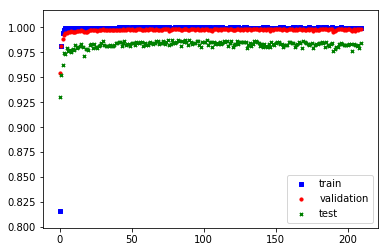

In [88]:
# Plot the model's accuracy output
import matplotlib.pyplot as plt

x = None
try:
    x = range(len(epoc_list))
except:
    pass

if x is not None:
    y = [ k[0] for k in epoc_list ]
    y_v = [ k[1] for k in epoc_list ]
    y_t = [ k[2] for k in epoc_list ]

    print("test max = {:.4f}".format(max(y_t)))

    fig = plt.figure()
    ax1 = fig.add_subplot(111)

    ax1.scatter(x, y, s=10, c='b', marker="s", label='train')
    ax1.scatter(x, y_v, s=10, c='r', marker="o", label='validation')
    ax1.scatter(x, y_t, s=10, c='g', marker="x", label='test')
    plt.legend(loc='bottom right');
    plt.show()

---

## Model Evaluation Report.

CNN Hog3 model is used instead of sermanet due to better test accuracy after training or 100 to 200 epochs. Test accuracy is greater than 98.5 is achived on training on the balanced and agumented larger data set. 

In [47]:
model_to_use = "./cnn-hog3-best"

---

## Step 2.5: Test a Model on Test Images

Show overall test accuracy and per class accuracy with precision and recall.

In [48]:
### Helpers to run evaluations and predictions
import tensorflow as tf

def top_k_predictions(X_data, k):
    g = tf.Graph()
    with g.as_default():
        conv1_keep_prob = tf.placeholder(tf.float32)
        fc1_keep_prob = tf.placeholder(tf.float32)
        x = tf.placeholder(tf.float32, (None, 32, 32, 1))
        with tf.variable_scope(model_scope):
            predictions = tf.nn.softmax(cnn_model(model_scope, x, fc1_keep_prob))
            tpk = tf.nn.top_k(predictions, k)
            
        saver = tf.train.Saver()

    with tf.Session(graph = g) as sess:
        sess.run(tf.global_variables_initializer())
        saver.restore(sess, model_to_use)

        [t] = sess.run([tpk], feed_dict = { x: X_data, conv1_keep_prob:1.0, fc1_keep_prob: 1.0 })
        return np.array(t)

def run_evaluation(X_test, y_test):
    g = tf.Graph()
    with g.as_default():
        # Encode data nodes
        conv1_keep_prob = tf.placeholder(tf.float32)
        fc1_keep_prob = tf.placeholder(tf.float32)
        x = tf.placeholder(tf.float32, (None, 32, 32, 1))
        y = tf.placeholder(tf.int32, (None))
        one_hot_y = tf.one_hot(y, 43)
    
        with tf.variable_scope(model_scope):
            logits = cnn_model(model_scope, x, fc1_keep_prob)
            # Eval
            correct_prediction = tf.equal(tf.argmax(logits, 1), tf.argmax(one_hot_y, 1))
            accuracy_operation = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

        saver = tf.train.Saver()
        
    with tf.Session(graph = g) as sess:
        sess.run(tf.global_variables_initializer())
        saver.restore(sess, model_to_use)
        return evaluate(X_test, y_test, sess, accuracy_operation, x, y, conv1_keep_prob, fc1_keep_prob)
    
def get_precision_set(y_test, y_pred):
    """
    Get precision set per class
    """
    ret_dict = {}     # it is dict { class : ( set of true results of the set of results , set of results ) }
    y_pred_dict = {}  # it is dict { class : [ index in y_test ] }
    for i in range(0, len(y_pred)):
        if y_pred[i] in y_pred_dict:
            y_pred_dict[y_pred[i]].append(i)
        else:
            y_pred_dict[y_pred[i]] = [i]
    
    # K : class, v : set of indexes into y_test
    for k, v in y_pred_dict.items():
        # Number of true predictions in the give prediction set
        l =[]
        for x in v:
            if y_test[x] == k:
                l.append(x)

        ret_dict[k] = (l, y_pred_dict[k])
        
    return ret_dict

def get_precision(y_test, y_pred):
    """
    Get precision set per class
    """
    pred_set_dict = get_precision_set(y_test, y_pred)

    ret_dict = {}     # it is dict { class : precision }

    for k, v in pred_set_dict.items():
        # Precision is true predictions in the given prediction set for a class by the
        # number of predictions for that class
        ret_dict[k] = float(len(v[0])) / len(v[1])
        
    return ret_dict

def get_recall(y_test, y_pred):
    """
    Get recall per class
    """
    ret_dict = {}  # it is dict { class : recall }
    
    # Build dict for y_test per class
    # will helps u know true size of each class.
    y_test_dict = {}
    for i in range(0, len(y_test)):
        if y_test[i] in y_test_dict:
            y_test_dict[y_test[i]].append(i)
        else:
            y_test_dict[y_test[i]] = [i]

    pred_set_dict = get_precision_set(y_test, y_pred)
    
    for k, v in pred_set_dict.items():
        # True predictions in the set of predictions for each class by total true examples in
        # test set per class.
        ret_dict[k] = float(len(pred_set_dict[k][0])) / len(y_test_dict[k])
        
    return ret_dict

---

### Overall Test set accuracy

In [49]:
# Lets show how it performed on our given test set in total and per label.
test_set_accuracy = run_evaluation(X_test, y_test)

print("Model performance with on test set size {} with test accuracy: {:.4f}".format(len(y_test), test_set_accuracy))

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best
Model performance with on test set size 12630 with test accuracy: 0.9873


---

### Show Precision and Recall Bar plot per class for given Test set.

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best


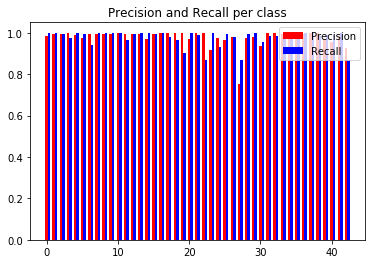

In [50]:
# Let us show precision and recall per class
import collections
import numpy as np
import matplotlib.pyplot as plt

sign_dict = load_signnames()

# get predictions for all of test set
def get_best_prediction(X_test):
    return [ int(x[0]) for x in top_k_predictions(X_test, 1)[1] ]
    
y_pred = get_best_prediction(X_test)

per_class_precision = get_precision(y_test, y_pred)

precision_od = [ v for k, v in collections.OrderedDict(sorted(per_class_precision.items())).items() ]

per_class_recall = get_recall(y_test, y_pred)

recall_od = [ v for k, v in collections.OrderedDict(sorted(per_class_recall.items())).items() ]

fig, ax = plt.subplots()
ind = np.arange(len(per_class_precision))  # the x locations for the groups
width = 0.35  

prec = ax.bar(ind, precision_od, width, color='r')
rec = ax.bar(ind + width, recall_od, width, color='b')

ax.set_title('Precision and Recall per class')

ax.legend((prec[0], rec[0]), ('Precision', 'Recall'))
plt.show()


---

### Show misclassified images orderd by worst performing class first

Top 10 recall looser class analysis with
22-Bumpy road , recall: 0.87


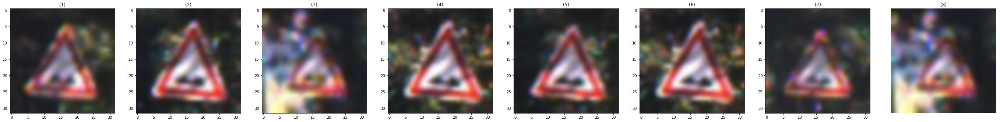

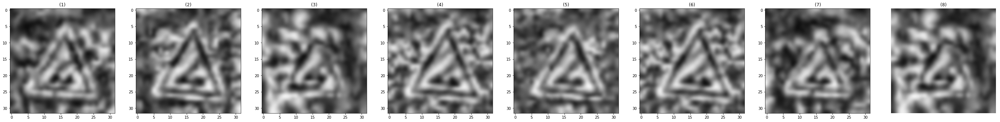

27-Pedestrians , recall: 0.87


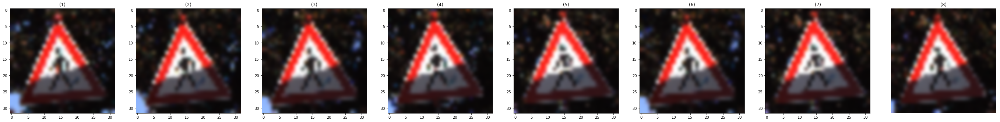

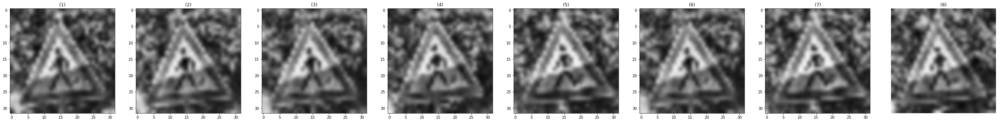

42-End of no passing by vehicles over 3.5 metric tons , recall: 0.87


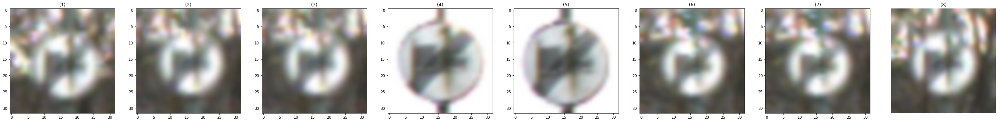

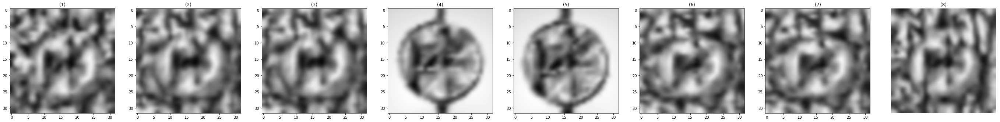

19-Dangerous curve to the left , recall: 0.90


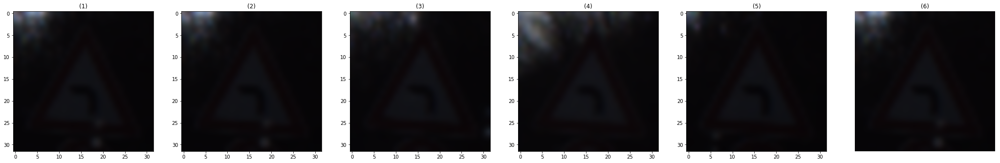

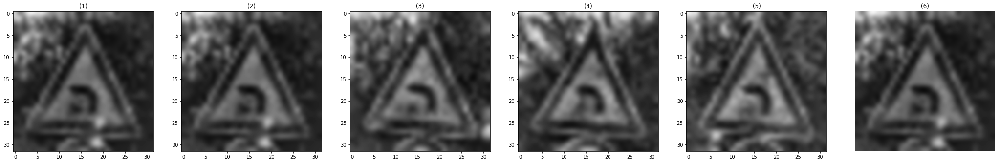

24-Road narrows on the right , recall: 0.93


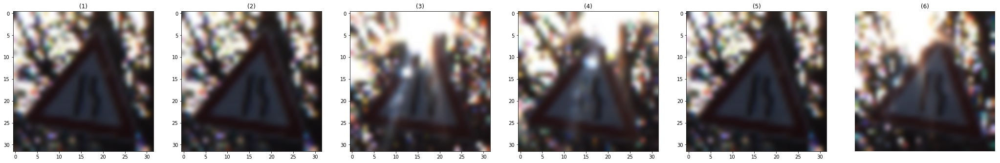

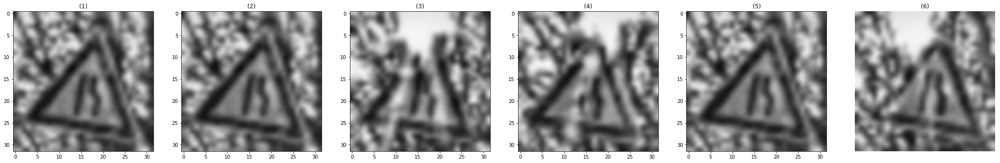

[None, None, None, None, None]

In [53]:
# Look at miss classified 8 images and see how they fared by increasing order of recall
recall_list = []
for i in range(0, len(recall_od)):
    recall_list.append((recall_od[i], i))
    
# Sort by recall %
recall_list.sort(key=lambda x: x[0])

precision_dict = get_precision_set(y_test, y_pred)

y_test_dict = {}
for i in range(0, len(y_test)):
    if y_test[i] in y_test_dict:
        y_test_dict[y_test[i]].append(i)
    else:
        y_test_dict[y_test[i]] = [i]

error_dict = {}
for k, v in precision_dict.items():
    error_dict[k] = list(set(y_test_dict[k]) - set(v[0]))

def show_class(class_id, recall):
    img_label = "{}-{}".format(class_id, sign_dict[class_id])
    
    print("{} , recall: {:.2f}".format(img_label, recall))
          
    r = np.random.randint(1, len(error_dict[class_id]), min(len(error_dict[class_id]), 8))
    img_list = [ test['features'][error_dict[class_id][x]] for x in r ]
    img_test_list = [ X_test[error_dict[class_id][x]] for x in r ]
    show_images(img_list)
    show_images(img_test_list)
  
print("Top 10 recall looser class analysis with")
[ show_class(x[1], x[0]) for x in recall_list[: 5] ]

---

## Step 3: Test a Model on New Images

To give yourself more insight into how your model is working, download at least five pictures of German traffic signs from the web and use your model to predict the traffic sign type.

You may find `signnames.csv` useful as it contains mappings from the class id (integer) to the actual sign name.

### Load and Output the Images

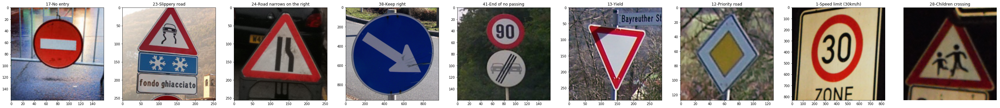

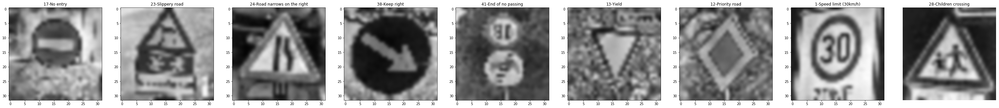

In [54]:
import csv
import cv2
from matplotlib import pyplot as plt
from skimage.transform import resize

test_images = [ "data/17_no_entry_crop.jpg", 
                "data/23_slippery_road_crop.jpg", 
                "data/24_road_narrows_on_the_right_crop.jpg",
                "data/38_keep_right.jpg",
                "data/41_end_of_no_passing_crop.jpg",
                "data/13_yield.jpg",
                "data/12_priority_road.jpg",
                "data/1_speed_limit_30.jpeg",
                "data/28_children_crossing.jpeg"]

sign_dict = load_signnames()

img_list = []
img_name_list = []
img_id_list = []
for t in test_images:
    sign_id = int(t.split('/')[1].split('_')[0])
    if sign_id not in sign_dict:
        print("Could not find id {} in dict for image {}".format(sign_id, t))
    else:
        img = cv2.imread(t)
        img_list.append(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        img_name_list.append('{}-{}'.format(str(sign_id), sign_dict[sign_id]))
        img_id_list.append(sign_id)
        
show_images(img_list, img_name_list)

def preprocess_with_resize(img_list, s=(32, 32, 1)):
    y_img_list = rbg_to_y_CLAHE(img_list)
    y_img_list = [ resize(i, output_shape=s) for i in y_img_list ]
    y_img_list = y_img_list - t_mean
    y_img_list = y_img_list / t_std
    return y_img_list

y_img_list = preprocess_with_resize(img_list)
show_images(y_img_list, img_name_list)

### Predict the Sign Type for Each Image

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best


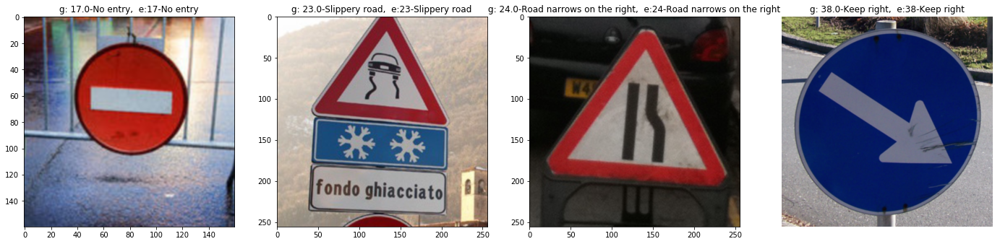

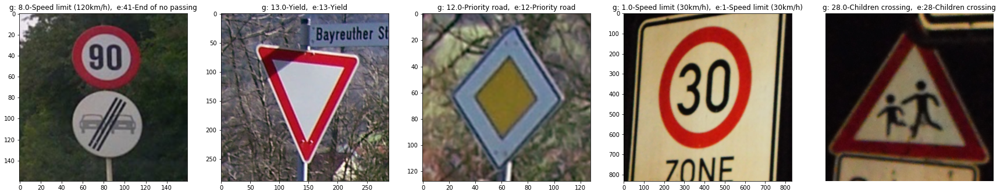

In [55]:
### Run the predictions here and use the model to output the prediction for each image.
### Make sure to pre-process the images with the same pre-processing pipeline used earlier.
### Feel free to use as many code cells as needed.
import tensorflow as tf
  
result = top_k_predictions(y_img_list, 1)[1]
result_name_list = []
for i in range(0, len(result)):
    r = None
    if result[i][0] not in sign_dict:
        print("Could not find id {} in dict for image {}".format(result[i][0], img_name_list[i]))
        r = '{}-{}'.format(str(result[i][0]), "None")
    else:
        r = '{}-{}'.format(str(result[i][0]), sign_dict[result[i][0]])
    
    result_name_list.append('g: {},  e:{}'.format(r, img_name_list[i]))

show_images(img_list[0:4], result_name_list[0:4]) 
show_images(img_list[4:], result_name_list[4:]) 


### Analyze Performance

In [58]:
### Calculate the accuracy for web images
### For example, if the model predicted 1 out of 5 signs correctly, it's 20% accurate on these new images.
def evaluate_accuracy(X_data, y_data):
    num_examples = len(X_data)
    total_accuracy = 0
    predictions = top_k_predictions(X_data, 1)[1]
    
    accurate_predictions_count = 0
    for i in range(0, len(y_data)):
        if y_data[i] == predictions[i][0]:
            accurate_predictions_count += 1
            
    return float(accurate_predictions_count) / len(y_data)

    
test_accuracy = evaluate_accuracy(y_img_list, img_id_list)
print("Web signs Accuracy = {:.3f}".format(test_accuracy))

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best
Web signs Accuracy = 0.889


### Output Top 5 Softmax Probabilities For Each Image Found on the Web

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best
Expected Result: No entry , recall: 0.980556


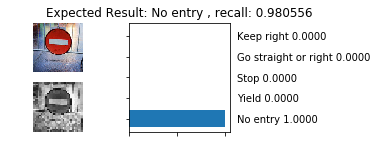

Expected Result: Slippery road , recall: 1.000000


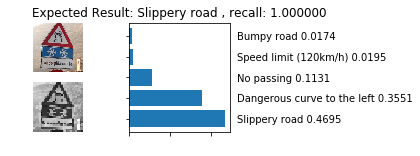

Expected Result: Road narrows on the right , recall: 0.933333


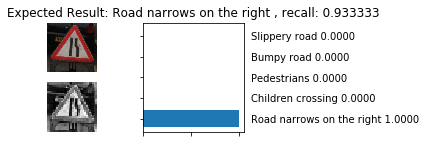

Expected Result: Keep right , recall: 0.984058


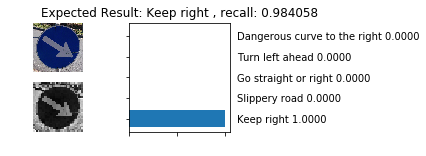

Expected Result: End of no passing , recall: 1.000000


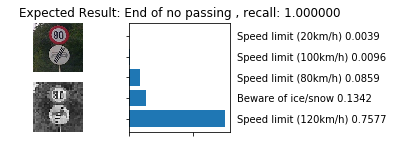

Expected Result: Yield , recall: 1.000000


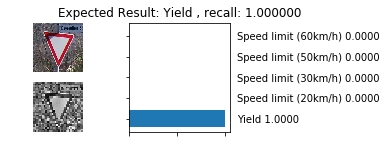

Expected Result: Priority road , recall: 0.994203


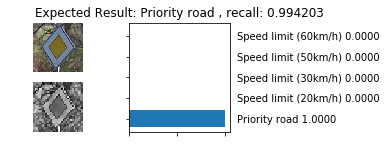

Expected Result: Speed limit (30km/h) , recall: 0.998611


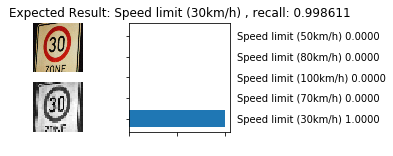

Expected Result: Children crossing , recall: 0.993333


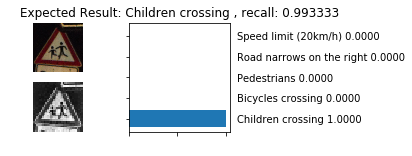

In [61]:
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
### Print out the top five softmax probabilities for the predictions on the German traffic sign images found on the web. 
### Feel free to use as many code cells as needed.

def plot_image_and_top_k_predictions(image_orig, image_processed, predictions, sign_dict, title=None, save=None):
    """
    https://github.com/navoshta/traffic-signs/blob/master/Traffic_Signs_Recognition.ipynb
    """
    # Prepare the grid
    fig = plt.figure(figsize = (4, 2))
    gridspec.GridSpec(2, 2)
    
    # Plot original image
    plt.subplot2grid((2, 2), (0, 0), colspan=1, rowspan=1)
    plt.imshow(image_orig)
    plt.axis('off')

    # Plot preprocessed image
    plt.subplot2grid((2, 2), (1, 0), colspan=1, rowspan=1)
    plt.imshow(image_processed.squeeze(), cmap='gray')
    plt.axis('off')

    # Plot predictions
    plt.subplot2grid((2, 2), (0, 1), colspan=1, rowspan=2)
    plt.barh(np.arange(5)+.5, predictions[0], align='center')
    plt.yticks(np.arange(5)+.5, [sign_dict[predictions[1][i].astype(int)] + " {:.4f}".format(predictions[0][i]) for i in range(0, len(predictions[1]))])
    plt.tick_params(axis='both', which='both', labelleft='off', labelright='on', labeltop='off', labelbottom='off')
    
    if title is not None:
        plt.title(s)
    plt.show()
    
    if save is not None:
        plt.draw()
        fig.savefig("examples/" + save + ".png", bbox_inches="tight")
    
result_top_5 = top_k_predictions(y_img_list, 5)
for i in range(0, len(y_img_list)):
    s = "Expected Result: {} , recall: {:4f}".format(sign_dict[img_id_list[i]], per_class_recall[img_id_list[i]])
    print(s)
    plot_image_and_top_k_predictions(img_list[i], y_img_list[i], [result_top_5[0][i], result_top_5[1][i]], sign_dict, title=s, save="smax-"+str(img_id_list[i]))
    
    

---

## Step 4 (Optional): Visualize the Neural Network's State with Test Images

In [82]:
### Visualize your network's feature maps here.
### Feel free to use as many code cells as needed.

# image_input: the test image being fed into the network to produce the feature maps
# tf_activation: should be a tf variable name used during your training procedure that represents the calculated state of a specific weight layer
# activation_min/max: can be used to view the activation contrast in more detail, by default matplot sets min and max to the actual min and max values of the output
# plt_num: used to plot out multiple different weight feature map sets on the same block, just extend the plt number for each new feature map entry

def outputFeatureMap(image_input, tf_activation, activation_min=-1, activation_max=-1 ,plt_num=1):
    # Here make sure to preprocess your image_input in a way your network expects
    # with size, normalization, ect if needed
    # image_input =
    # Note: x should be the same name as your network's tensorflow data placeholder variable
    # If you get an error tf_activation is not defined it may be having trouble accessing the variable from inside a function
    activation = tf_activation.eval(session=sess,feed_dict={x : image_input})
    featuremaps = activation.shape[3]
    fig = plt.figure(figsize = (10, 10))
    gs1 = gridspec.GridSpec(int(featuremaps/10)+1, 10)
    # gs1.update(wspace=0.025, hspace=0.05) # set the spacing between axes. 
    for featuremap in range(featuremaps):
        #ax = plt.subplot(8,16, featuremap+1) # sets the number of feature maps to show on each row and column
        ax = plt.subplot(gs1[featuremap]) # sets the number of feature maps to show on each row and column
        #plt.title(str(featuremap)) # displays the feature map number
        plt.axis('off')
        ax.set_aspect('equal')
        if activation_min != -1 & activation_max != -1:
            ax.imshow(activation[0,:,:, featuremap], interpolation="bicubic", vmin =activation_min, vmax=activation_max, cmap="gray")
        elif activation_max != -1:
            ax.imshow(activation[0,:,:, featuremap], interpolation="bicubic", vmax=activation_max, cmap="gray")
        elif activation_min !=-1:
            ax.imshow(activation[0,:,:, featuremap], interpolation="bicubic", vmin=activation_min, cmap="gray")
        else:
            ax.imshow(activation[0,:,:, featuremap], interpolation="bicubic", cmap="gray")
    return fig

conv1 (32, 32, 100) -> pool1 (16, 16, 100) -> conv2 (16, 16, 150) -> pool2 (8, 8, 150) -> conv3 (8, 8, 250) -> pool3 (4, 4, 250) -> flatten 4000 -> fc1 1024 -> fc2 100 -> out 43
INFO:tensorflow:Restoring parameters from ./cnn-hog3-best


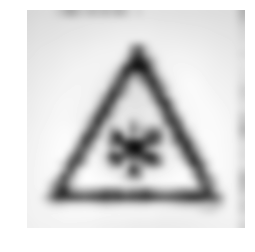

Conv layer 1, count: 100


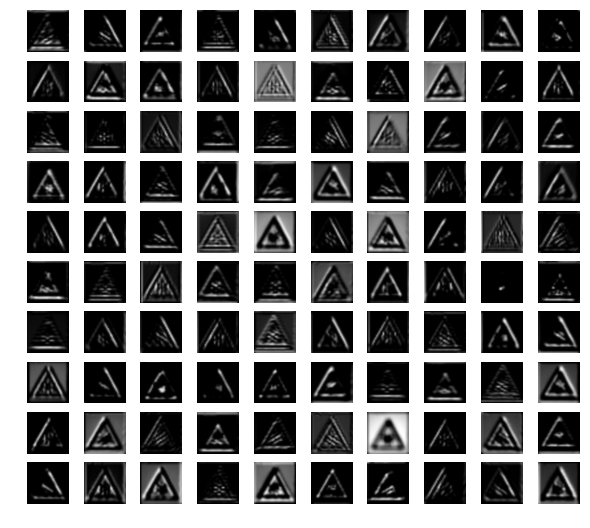

In [85]:
graph = tf.Graph()
with graph.as_default():
    conv1_keep_prob = tf.placeholder(tf.float32)
    fc1_keep_prob = tf.placeholder(tf.float32)
    x = tf.placeholder(tf.float32, (None, 32, 32, 1))
    with tf.variable_scope(model_scope):
        predictions = tf.nn.softmax(cnn_model(model_scope, x, fc1_keep_prob))
        tpk = tf.nn.top_k(predictions, k)
            
        saver = tf.train.Saver()

    with tf.Session(graph = graph) as sess:
        sess.run(tf.global_variables_initializer())
        saver.restore(sess, model_to_use)

        [t] = sess.run([tpk], feed_dict = { x: X_test, conv1_keep_prob:1.0, fc1_keep_prob: 1.0 })

        r = np.random.randint(1, n_test)
        fig = plt.figure(figsize = (4, 4))
        plt.axis('off')
        plt.imshow(X_test[r].squeeze(), cmap="gray", interpolation="bicubic")
        plt.show()
        plt.draw()
        fig.savefig("examples/activ_img_test.png")
        
        print("Conv layer 1, count: {}".format(conv1.get_shape()[3]))
        with tf.variable_scope('conv1', reuse = True):
            fig = outputFeatureMap([X_test[r]], conv1, plt_num=1)
            plt.show() 
            plt.draw()
            fig.savefig("examples/conv1_layer_visual.png")
        


INFO:tensorflow:Restoring parameters from ./cnn-hog3-best


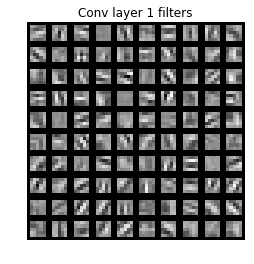

In [87]:
from math import sqrt

"""
https://gist.github.com/kukuruza/03731dc494603ceab0c5
"""
def put_kernels_on_grid (kernel, pad = 1):

  '''Visualize conv. filters as an image (mostly for the 1st layer).
  Arranges filters into a grid, with some paddings between adjacent filters.
  Args:
    kernel:            tensor of shape [Y, X, NumChannels, NumKernels]
    pad:               number of black pixels around each filter (between them)
  Return:
    Tensor of shape [1, (Y+2*pad)*grid_Y, (X+2*pad)*grid_X, NumChannels].
  '''
  # get shape of the grid. NumKernels == grid_Y * grid_X
  def factorization(n):
    for i in range(int(sqrt(float(n))), 0, -1):
      if n % i == 0:
        if i == 1: print('Who would enter a prime number of filters')
        return (i, int(n / i))
  (grid_Y, grid_X) = factorization (kernel.get_shape()[3].value)
  # print ('grid: %d = (%d, %d)' % (kernel.get_shape()[3].value, grid_Y, grid_X))

  x_min = tf.reduce_min(kernel)
  x_max = tf.reduce_max(kernel)
  kernel = (kernel - x_min) / (x_max - x_min)

  # pad X and Y
  x = tf.pad(kernel, tf.constant( [[pad,pad],[pad, pad],[0,0],[0,0]] ), mode = 'CONSTANT')

  # X and Y dimensions, w.r.t. padding
  Y = kernel.get_shape()[0] + 2 * pad
  X = kernel.get_shape()[1] + 2 * pad

  channels = kernel.get_shape()[2]

  # put NumKernels to the 1st dimension
  x = tf.transpose(x, (3, 0, 1, 2))
  # organize grid on Y axis
  x = tf.reshape(x, tf.stack([grid_X, Y * grid_Y, X, channels]))

  # switch X and Y axes
  x = tf.transpose(x, (0, 2, 1, 3))
  # organize grid on X axis
  x = tf.reshape(x, tf.stack([1, X * grid_X, Y * grid_Y, channels]))

  # back to normal order (not combining with the next step for clarity)
  x = tf.transpose(x, (2, 1, 3, 0))

  # to tf.image_summary order [batch_size, height, width, channels],
  #   where in this case batch_size == 1
  x = tf.transpose(x, (3, 0, 1, 2))

  # scaling to [0, 255] is not necessary for tensorboard
  return x.eval()

with tf.Session(graph = graph) as sess:
    saver.restore(sess, model_to_use)

    saved_dict = {}
    for x in tf.trainable_variables():
        #print("{}={}".format(x.name, x.get_shape()))
        saved_dict[x.name] = x

    # Visualize conv1 kernels
    weights = saved_dict["cnn_hog3/conv1/weights:0"]
    grid = put_kernels_on_grid (weights)
    fig = plt.figure(figsize = (4, 4))
    plt.axis('off')
    plt.imshow(grid[0].squeeze(), cmap="gray", interpolation="nearest")
    plt.title("Conv layer 1 filters")
    plt.show()
    plt.draw()
    fig.savefig("examples/conv1_layer_weights.png")